## Importing Necessary Libraries and SExtractor

In [31]:
import os
import glob
import numpy as np
import pandas as pd
import subprocess
import random

import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
from matplotlib import patches

from astropy.io import fits
from astropy.nddata import Cutout2D
from astropy.stats import biweight_location, mad_std, sigma_clipped_stats, SigmaClip

from photutils.profiles import RadialProfile
from photutils.background import Background2D, SExtractorBackground
from photutils.segmentation import detect_threshold, detect_sources
from photutils.centroids import centroid_2dg

from scipy.ndimage import binary_dilation

import warnings
warnings.filterwarnings('ignore')

source_extractor = '/home/rabbit/sextractor-master/src/sex'

print("Libraries imported and SExtractor path set")

Libraries imported and SExtractor path set


## Plotting the FITS Image with the Headers

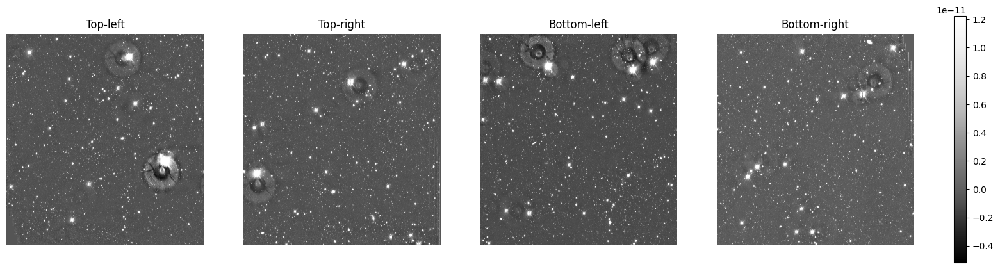

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -32 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                18711 / Number of pixels along this axis               NAXIS2  =                20033 / Number of pixels along this axis               EXTEND  =                    T / This file may contain FITS extensions          OBJECT  = 'KIDS_9.5_-33.1'                                                      ZEROPNT =                  0.0                                                  ZPNTERR =                  0.0                                                  CREADATE= '2018-05-09T00:41:45.000'                                             PSF_RAD =   0.6659591674804688                                                  INSTRUME= 'OMEGACAM'                                                            TELESCOP= 'ESO-VLT-U0'                  

In [2]:
fits_path = '/home/rabbit/PSF_BuildUp/FITS_images/KIDS_9.5_-33.1.fits'

with fits.open(fits_path, memmap=True) as hdul:
    data = hdul[0].data
    header = hdul[0].header  

ny, nx = data.shape
cy, cx = ny // 2, nx // 2


quad1 = data[:cy, :cx] 
quad2 = data[:cy, cx:]  
quad3 = data[cy:, :cx]   
quad4 = data[cy:, cx:]   

quads = [quad1, quad2, quad3, quad4]
titles = ['Top-left', 'Top-right', 'Bottom-left', 'Bottom-right']

fig, axes = plt.subplots(1, 4, figsize=(20, 5))
for ax, q, t in zip(axes, quads, titles):
    im = ax.imshow(q, origin='lower', cmap='Greys_r',
                   vmin=np.percentile(q, 1),
                   vmax=np.percentile(q, 99))
    ax.set_title(t)
    ax.axis('off')

plt.colorbar(im, ax=axes, fraction=0.046, pad=0.04)
plt.show()

print(header)

for key, value in header.items():
    print(f"{key}: {value}")

## Setting Outparameter and Convolution Filters

In [3]:
pixscale = 0.2

fitspath = '/home/rabbit/PSF_BuildUp/FITS_images/'
fits_pathlist = sorted(glob.glob(fitspath+'*.fits'))
fits_list = sorted([os.path.basename(f) for f in glob.glob(fitspath+'*.fits')])

seinpath = os.path.join(fitspath, 'se_in_out/')
os.makedirs(seinpath, exist_ok=True)

seinpath = os.path.join(fitspath, 'se_in_out/')
seoutpath = seinpath

out_param_path = os.path.join(seinpath, 'default.param')
conv_filter = '/usr/local/share/sextractor/gauss_3.0_5x5.conv'

## Setting up the Catalog

In [4]:
nnw_path = "/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/default.nnw"
psf_path = "/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/default.psf"

env = os.environ.copy()
env['LD_LIBRARY_PATH'] = '/home/rabbit/miniforge3/envs/psf/lib:' + env.get('LD_LIBRARY_PATH','')

for i, filename in enumerate(fits_list, start=1):

    image_file = fits_pathlist[i-1]
    base_name = os.path.splitext(filename)[0]

    cat_out_name = os.path.join(seoutpath, f'outparams_{base_name}.cat')
    template_path = os.path.join(seinpath, f'{base_name}.SEtemplate')

    with open(template_path, 'w') as f:
        f.write(f"""CATALOG_NAME     {cat_out_name}
CATALOG_TYPE     ASCII_HEAD
PARAMETERS_NAME  {out_param_path}

DETECT_TYPE      CCD
DETECT_MINAREA   20
DETECT_THRESH    3.0
ANALYSIS_THRESH  3.0

FILTER           Y
FILTER_NAME      {conv_filter}

DEBLEND_NTHRESH  32
DEBLEND_MINCONT  0.005

CLEAN            Y
CLEAN_PARAM      1.0

WEIGHT_TYPE      NONE
WEIGHT_IMAGE     -

FLAG_IMAGE       flag.fits
FLAG_TYPE        OR

PHOT_APERTURES   10
PHOT_AUTOPARAMS  2.5,3.5
PHOT_PETROPARAMS 2.0,3.5
PHOT_AUTOAPERS   0.0,0.0

SATUR_LEVEL      4.0e-08
SATUR_KEY        SATURATE

MAG_ZEROPOINT    0.0
MAG_GAMMA        4.0
GAIN             1.0
GAIN_KEY         GAIN
PIXEL_SCALE      {pixscale}

SEEING_FWHM      0.6659591674804688
STARNNW_NAME     {nnw_path}
PSF_NAME         {psf_path}

CHECKIMAGE_TYPE  SEGMENTATION,BACKGROUND,BACKGROUND_RMS
CHECKIMAGE_NAME  {seoutpath}/segmap_{base_name}.fits,{seoutpath}/bkg_{base_name}.fits,{seoutpath}/bkg_rms_{base_name}.fits

BACK_TYPE        AUTO
BACK_SIZE        128
BACK_FILTERSIZE  3

MEMORY_OBJSTACK  50000
MEMORY_PIXSTACK  3000000
MEMORY_BUFSIZE   8000

VERBOSE_TYPE     NORMAL
HEADER_SUFFIX    .head
WRITE_XML        N
XML_NAME         sex.xml
XSL_URL          file:///usr/local/share/sextractor/sextractor.xsl
""")

    print(f"\nSE template written for {base_name}")
    print(f"Running SExtractor for {base_name} ({i}/{len(fits_list)}) ...")

    try:
        subprocess.run(
            [source_extractor, image_file, '-c', template_path],
            check=True,
            env=env
        )
        print(f"SExtractor ran successfully for {base_name}")

    except subprocess.CalledProcessError as e:
        print(f"Warning: SExtractor failed for {base_name} (exit code {e.returncode})")

print(f"\nSExtractor ran for all {len(fits_list)} FITS files.")


SE template written for KIDS_9.5_-33.1
Running SExtractor for KIDS_9.5_-33.1 (1/1) ...


> 
----- SExtractor 2.29.0 started on 2026-02-28 at 14:54:47 with 12 threads

> Setting catalog parameters
> Reading detection filter
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for KIDS_9.5_-33.1.fits
----- Measuring from: KIDS_9.5_-33.1.fits
      "KIDS_9.5_-33.1" / no ext. header / 18711x20033 / 32 bits (floats)
Detection+Measurement image: > Setting up background maps
> Setting up background map at line:  128
> Setting up background map at line:  256
> Setting up background map at line:  384
> Setting up background map at line:  512
> Setting up background map at line:  640
> Setting up background map at line:  768
> Setting up background map at line:  896
> Setting up background map at line: 1024
> Setting up background map at line: 1152
> Setting up background map at line: 1280
> Setting up background map at line: 1408
> Setting up background map at line: 1536
> Setting up background map at line: 16

SExtractor ran successfully for KIDS_9.5_-33.1

SExtractor ran for all 1 FITS files.



## Print the Segmentation Map

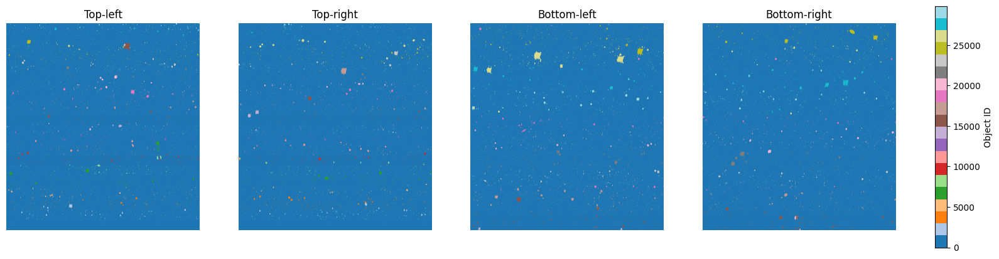

In [5]:
segmap_path = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/segmap_KIDS_9.5_-33.1.fits'

with fits.open(segmap_path, memmap=True) as seg_hdu:
    seg_data = seg_hdu[0].data

ny, nx = seg_data.shape
cy, cx = ny // 2, nx // 2

quad1 = seg_data[:cy, :cx]
quad2 = seg_data[:cy, cx:]
quad3 = seg_data[cy:, :cx]
quad4 = seg_data[cy:, cx:]

quads = [quad1, quad2, quad3, quad4]
titles = ['Top-left', 'Top-right', 'Bottom-left', 'Bottom-right']

fig, axes = plt.subplots(1, 4, figsize=(20, 5))

for ax, q, t in zip(axes, quads, titles):
    im = ax.imshow(q, origin='lower', cmap='tab20')
    ax.set_title(t)
    ax.axis('off')

plt.colorbar(im, ax=axes, fraction=0.046, pad=0.04, label='Object ID')
plt.show()

## Plotting the Background and Bankground Substracted Images

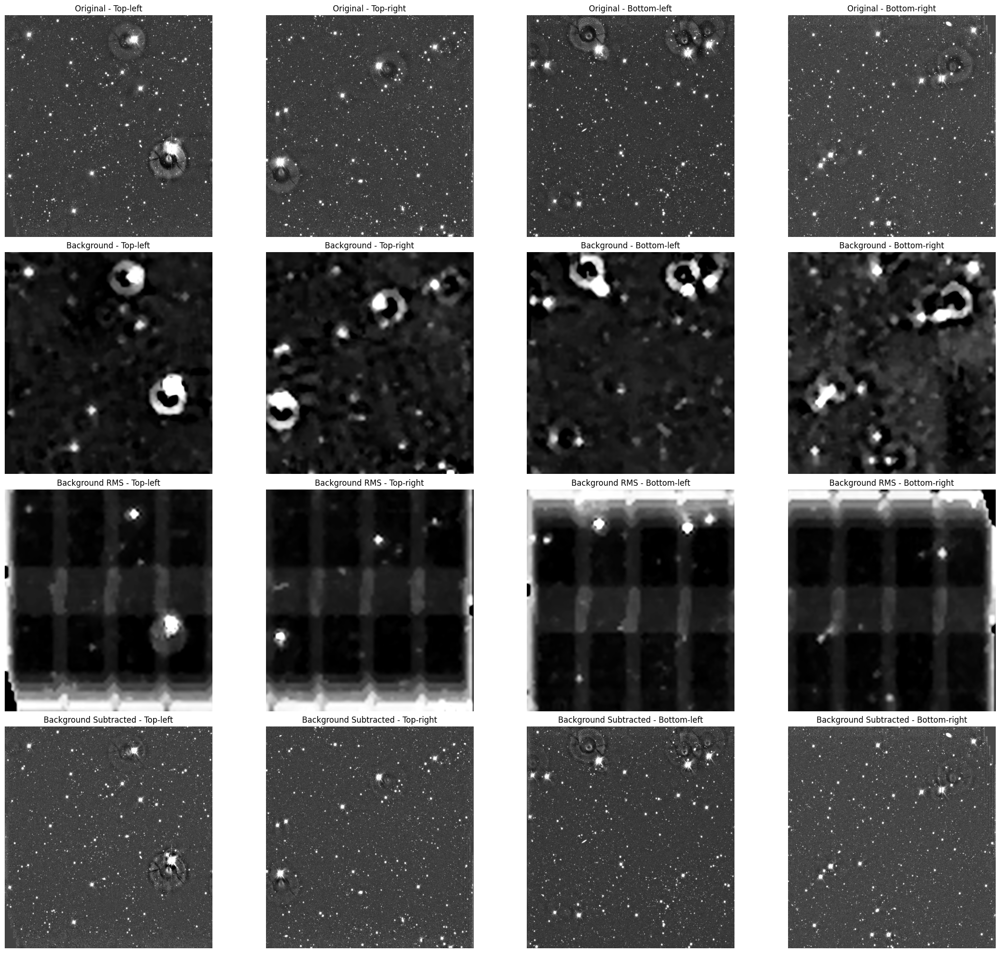

Background-subtracted image saved to: /home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_bySExtractor.fits


In [6]:
fits_path = '/home/rabbit/PSF_BuildUp/FITS_images/KIDS_9.5_-33.1.fits'
bkg_path = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_KIDS_9.5_-33.1.fits'
bkg_rms_path = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_rms_KIDS_9.5_-33.1.fits'

with fits.open(fits_path, memmap=True) as hdul_raw, \
     fits.open(bkg_path, memmap=True) as hdul_bkg, \
     fits.open(bkg_rms_path, memmap=True) as hdul_rms:

    raw_data = hdul_raw[0].data
    header = hdul_raw[0].header
    bkg_data = hdul_bkg[0].data
    bkg_rms_data = hdul_rms[0].data

subtracted_data = raw_data - bkg_data


def split_quads(data):
    ny, nx = data.shape
    cy, cx = ny // 2, nx // 2
    return [
        data[:cy, :cx],   
        data[:cy, cx:],   
        data[cy:, :cx],   
        data[cy:, cx:]   
    ]


datasets = [
    split_quads(raw_data),
    split_quads(bkg_data),
    split_quads(bkg_rms_data),
    split_quads(subtracted_data)
]

row_titles = [
    'Original',
    'Background',
    'Background RMS',
    'Background Subtracted'
]

quad_titles = ['Top-left', 'Top-right', 'Bottom-left', 'Bottom-right']


fig, axes = plt.subplots(4, 4, figsize=(22, 20), constrained_layout=True)

for i in range(4):        
    for j in range(4):    
        q = datasets[i][j][::4, ::4]
        vmin, vmax = np.percentile(q, 5), np.percentile(q, 99)

        im = axes[i, j].imshow(q,
                               origin='lower',
                               cmap='Greys_r',
                               vmin=vmin,
                               vmax=vmax)

        axes[i, j].set_title(f'{row_titles[i]} - {quad_titles[j]}')
        axes[i, j].axis('off')

plt.show()


out_dir = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/'
os.makedirs(out_dir, exist_ok=True)

bkg_sub_path = os.path.join(out_dir, 'bkg_bySExtractor.fits')

fits.writeto(bkg_sub_path,
             subtracted_data.astype('float32'),
             header=header,
             overwrite=True)

print(f"Background-subtracted image saved to: {bkg_sub_path}")

## Estimate the Background using Photutils library

## Identify the Point Sources

Found 5914 point sources
          X_IMAGE     Y_IMAGE  MAG_AUTO  CLASS_STAR
0       7518.7080   3943.1531    8.9924       0.845
1       9995.2441   3418.2776   10.1009       0.845
2      17282.1289    448.3371   12.5843       0.845
3      16371.1016    366.8934   12.0071       0.845
4      17385.9023    194.9127   13.4007       0.845
...           ...         ...       ...         ...
29773   1577.4659  15943.6602   16.1342       0.967
29791  11272.7607  15933.9736   22.9240       0.955
29793    375.5530  15901.9307   16.3505       0.989
29800   1277.9769  15924.1816   23.1337       0.943
29802   5835.0898  15930.5127   23.3946       0.858

[5914 rows x 4 columns]


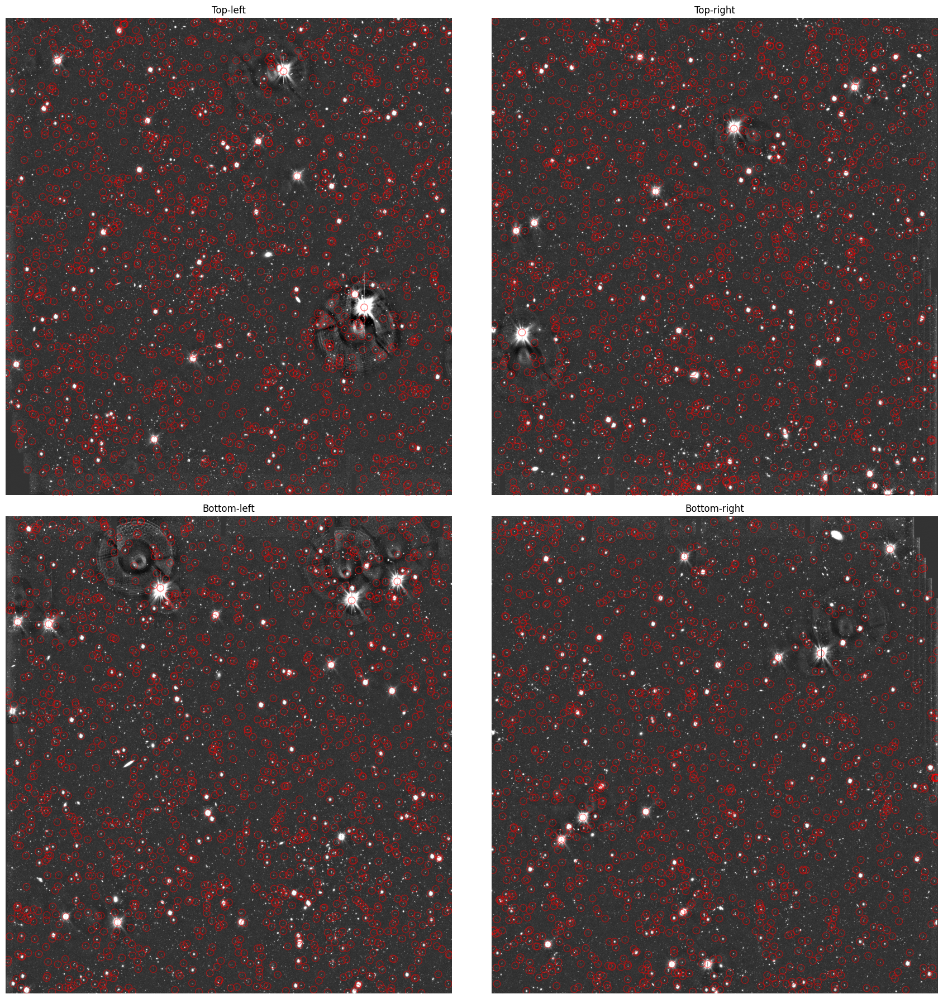

In [7]:
fits_path = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_bySExtractor.fits'
cat_file = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/outparams_KIDS_9.5_-33.1.cat'

with fits.open(fits_path, memmap=True) as hdul:
    img_data = hdul[0].data

columns = []
with open(cat_file, 'r') as f:
    for line in f:
        if line.startswith('#'):
            parts = line.replace('#','').strip().split()
            if len(parts) >= 2:
                columns.append(parts[1])
        else:
            break
catalog = pd.read_csv(cat_file, comment='#', sep=r'\s+', names=columns)

point_sources = catalog[catalog['CLASS_STAR'] >= 0.84]
print(f"Found {len(point_sources)} point sources")
print(point_sources[['X_IMAGE', 'Y_IMAGE', 'MAG_AUTO', 'CLASS_STAR']])


def split_quadrants(image, sources):
    ny, nx = image.shape
    cy, cx = ny // 2, nx // 2
    
    quads = [
        image[:cy, :cx],  
        image[:cy, cx:],
        image[cy:, :cx],  
        image[cy:, cx:]   
    ]
    
    source_quads = []
    for qx, qy, qimg in [(0, 0, quads[0]), (cx, 0, quads[1]), (0, cy, quads[2]), (cx, cy, quads[3])]:
        mask = (
            (point_sources['X_IMAGE'] >= qx) & 
            (point_sources['X_IMAGE'] < qx + qimg.shape[1]) &
            (point_sources['Y_IMAGE'] >= qy) & 
            (point_sources['Y_IMAGE'] < qy + qimg.shape[0])
        )
        sources_in_quad = point_sources[mask].copy()
        sources_in_quad['X_IMAGE'] -= qx
        sources_in_quad['Y_IMAGE'] -= qy
        source_quads.append(sources_in_quad)
    
    return quads, source_quads

image_quads, sources_quads = split_quadrants(img_data, point_sources)
vmin, vmax = np.percentile(img_data, 5), np.percentile(img_data, 99)
quad_titles = ['Top-left', 'Top-right', 'Bottom-left', 'Bottom-right']

fig, axes = plt.subplots(2, 2, figsize=(18, 18))

vmin, vmax = np.percentile(img_data, 5), np.percentile(img_data, 99)

for ax, qimg, qs, title in zip(axes.flat, image_quads, sources_quads, quad_titles):
    qimg_ds = qimg[::2, ::2]

    ax.imshow(qimg_ds, origin='lower', cmap='gray', vmin=vmin, vmax=vmax)

    ax.scatter(qs['X_IMAGE'].values / 2.0,
               qs['Y_IMAGE'].values / 2.0,
               s=80, edgecolor='red', facecolors='none', linewidth=1, alpha=0.5)

    ax.set_xlim(0, max([q.shape[1] for q in image_quads]) // 2)
    ax.set_ylim(0, max([q.shape[0] for q in image_quads]) // 2)
    ax.set_aspect('equal', adjustable='box')

    ax.set_title(title)
    ax.axis('off')

plt.tight_layout()

## Mag_Auto vs Flux_Radius Visualization

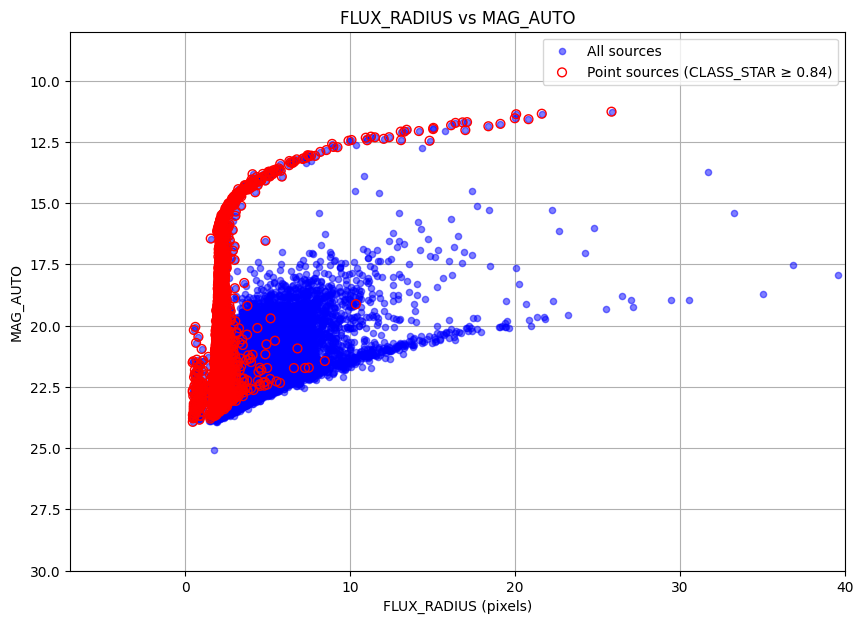

In [8]:
cat_file = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/outparams_KIDS_9.5_-33.1.cat'

columns = []
with open(cat_file, 'r') as f:
    for line in f:
        if line.startswith('#'):
            parts = line.replace('#','').strip().split()
            if len(parts) >= 2:
                columns.append(parts[1])
        else:
            break

catalog = pd.read_csv(cat_file, comment='#', sep=r'\s+', names=columns)
point_sources = catalog[catalog['CLASS_STAR'] >= 0.84]

fig, ax = plt.subplots(figsize=(10,7))
ax.scatter(catalog['FLUX_RADIUS'], catalog['MAG_AUTO'], s=20, color='blue', alpha=0.5, label='All sources')
ax.scatter(point_sources['FLUX_RADIUS'], point_sources['MAG_AUTO'], s=40,
           edgecolor='red', facecolors='none', label='Point sources (CLASS_STAR ≥ 0.84)')

'''rects = [
    ((3.3, 15.6), 1.4, 3.4, 'teal'),
    ((4.2, 13.8), 2.4, 1.1, 'blue'),
    ((7.1, 12.8), 2.8, 1.1, 'orange'),
    ((11.7, 11.6), 6.7, 1.2, 'pink')
]
for (x,y), w, h, color in rects:
    ax.add_patch(patches.Rectangle((x,y), w, h, linewidth=1, edgecolor=color, facecolor='none'))'''
'''core 17-22.5
intermediate 14-17
outer 1 12.5-14
outer 2 birghter flux rad 18 cut'''
ax.set_xlim(-7,40)
ax.set_ylim(30, 8)  
ax.set_xlabel('FLUX_RADIUS (pixels)')
ax.set_ylabel('MAG_AUTO')
ax.set_title('FLUX_RADIUS vs MAG_AUTO')
ax.legend()
ax.grid(True)
ax.set_axisbelow(True)
plt.show()

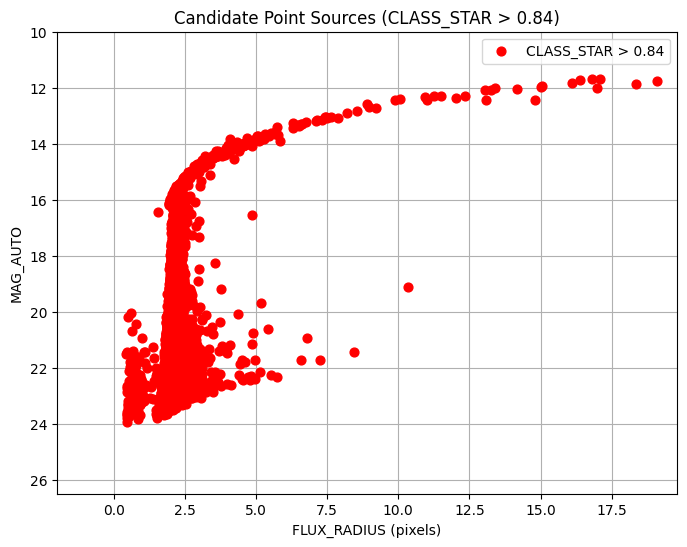

Total candidate stars: 5902


In [9]:
columns = []
with open(cat_file, 'r') as f:
    for line in f:
        if line.startswith('#'):
            parts = line.replace('#','').strip().split()
            if len(parts) >= 2:
                columns.append(parts[1])
        else:
            break

catalog = pd.read_csv(cat_file, comment='#', sep=r'\s+', names=columns)

point_sources = catalog[catalog['CLASS_STAR'] > 0.84]
fig, ax = plt.subplots(figsize=(8,6))
ax.scatter(point_sources['FLUX_RADIUS'], point_sources['MAG_AUTO'],
           s=40, edgecolor='red', facecolors='red', label='CLASS_STAR > 0.84')

ax.set_xlim(-2, 19.8)
ax.set_ylim(26.5, 10)  
ax.set_xlabel('FLUX_RADIUS (pixels)')
ax.set_ylabel('MAG_AUTO')
ax.set_title('Candidate Point Sources (CLASS_STAR > 0.84)')
ax.legend()
ax.grid(True)
ax.set_axisbelow(True)
plt.show()

print(f"Total candidate stars: {len(point_sources)}")

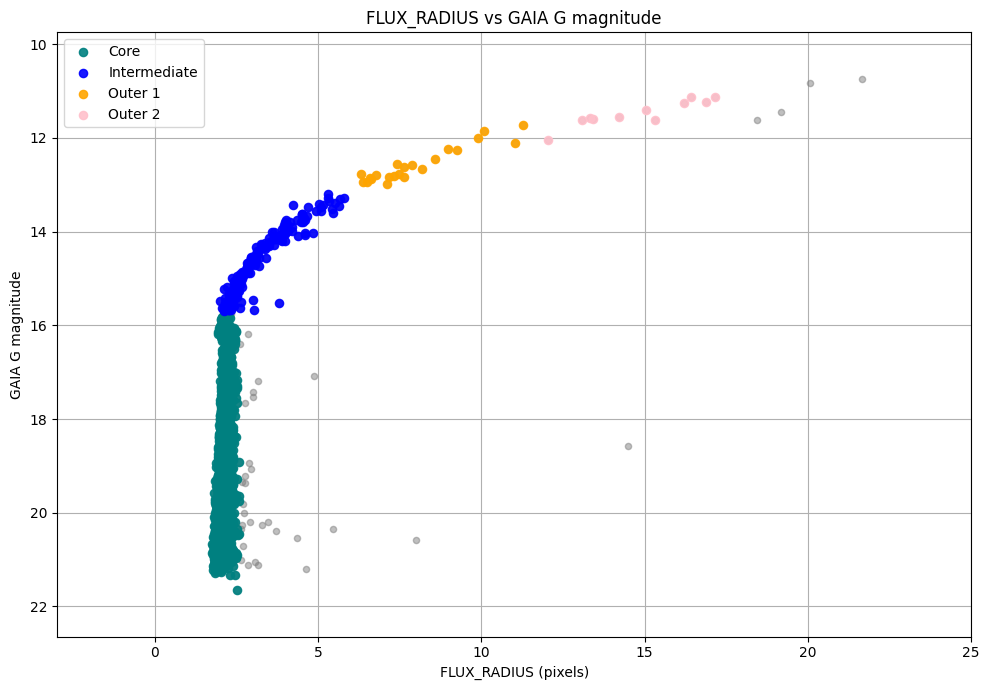

In [22]:
matched_file = '/home/rabbit/PSF_BuildUp/Query_results/gaia/gaia_matched_psf.csv'
matched_catalog = pd.read_csv(matched_file)

fig, ax = plt.subplots(figsize=(10, 7))

ax.scatter(
    matched_catalog['FLUX_RADIUS'],
    matched_catalog['GAIA_Gmag'],
    s=20,
    color='gray',
    alpha=0.5
)

regions = [
    (1.3, 2.6, 15.8, 21.8, 'teal', 'Core'),
    (1.85, 6.1, 12.8, 15.7, 'blue', 'Intermediate'),
    (6.3, 11.6, 11.6, 13.25, 'orange', 'Outer 1'),
    (12, 18, 11, 12.2, 'pink', 'Outer 2')
]

for x_min, x_max, y_min, y_max, color, label in regions:
    mask = (
        (matched_catalog['FLUX_RADIUS'] >= x_min) &
        (matched_catalog['FLUX_RADIUS'] <= x_max) &
        (matched_catalog['GAIA_Gmag'] >= y_min) &
        (matched_catalog['GAIA_Gmag'] <= y_max)
    )

    ax.scatter(
        matched_catalog.loc[mask, 'FLUX_RADIUS'],
        matched_catalog.loc[mask, 'GAIA_Gmag'],
        s=35,
        color=color,
        alpha=0.9,
        label=label
    )
    '''rect = patches.Rectangle(
        (x_min, y_min),
        x_max - x_min,
        y_max - y_min,
        linewidth=1.5,
        edgecolor=color,
        facecolor='none'
    )
    ax.add_patch(rect)'''
    
ax.set_xlim(-3, 25)
ax.set_ylim(
    matched_catalog['GAIA_Gmag'].max() + 1,
    matched_catalog['GAIA_Gmag'].min() - 1
)

ax.set_xlabel('FLUX_RADIUS (pixels)')
ax.set_ylabel('GAIA G magnitude')
ax.set_title('FLUX_RADIUS vs GAIA G magnitude')

ax.legend()
ax.grid(True)
ax.set_axisbelow(True)

plt.tight_layout()
plt.show()

In [23]:
fits_file = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_bySExtractor.fits'
cat_path  = '/home/rabbit/PSF_BuildUp/Query_results/gaia/gaia_matched_psf.csv'

PATCHES = [
    (1.3, 3.9, 15.8, 21.8, 100, 'Core'),
    (1.85, 6.1, 12.8, 15.7, 200, 'Intermediate'),
    (6.3, 11.6, 11.6, 13.25, 500, 'Outer 1'),
    (12, 18, 11, 12.2, 1000, 'Outer 2')
]


for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    os.makedirs(cutouts_dir, exist_ok=True)

def get_patch(flux_radius, mag):
    for fr_min, fr_max, m_min, m_max, size, folder in PATCHES:
        if fr_min <= flux_radius <= fr_max and m_min <= mag <= m_max:
            return size, os.path.join(folder, 'cutouts')
    return None, None

with fits.open(fits_file, memmap=True) as h:
    img = h[0].data

ny, nx = img.shape
print(f'Image shape: {ny} x {nx}')


cat = pd.read_csv(cat_path)

patch_counts = {folder: 0 for _, _, _, _, _, folder in PATCHES}

for _, row in cat.iterrows():
    if row['GAIA_StarProb'] < 0.98:
        continue
    _, folder_path = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if folder_path:
        patch_counts[os.path.basename(os.path.dirname(folder_path))] += 1

print('Cutout counts by patch:', patch_counts)

saved_files = 0

for _, row in cat.iterrows():
    if row['GAIA_StarProb'] < 0.98:
        continue

    size, folder_path = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if size is None:
        continue

    x, y = row['X_IMAGE'] - 1, row['Y_IMAGE'] - 1

    cut = Cutout2D(img, (x, y), (size, size), mode='partial')
    
    out_name = os.path.join(folder_path, f'cutout_{int(row["NUMBER"])}_{size}.fits')
    fits.writeto(out_name, cut.data.astype('float32'), overwrite=True)
    saved_files += 1

print(f'Total saved cutouts: {saved_files}')

for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    cutout_files = sorted([f for f in os.listdir(cutouts_dir) if f.endswith('.fits')])
    if not cutout_files:
        continue

    n_cols = 5
    n_rows = int(np.ceil(len(cutout_files) / n_cols))
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 3*n_rows))
    axes = axes.flatten()

    for ax, fname in zip(axes, cutout_files):
        path = os.path.join(cutouts_dir, fname)
        data = fits.getdata(path)
        vmin, vmax = np.percentile(data, 3), np.percentile(data, 97)
        ax.imshow(data, origin='lower', cmap='gray', vmin=vmin, vmax=vmax)
        ax.set_title(fname, fontsize=8)
        ax.axis('off')

    for ax in axes[len(cutout_files):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

Image shape: 20033 x 18711
Cutout counts by patch: {'Core': 1937, 'Intermediate': 201, 'Outer 1': 16, 'Outer 2': 10}
Total saved cutouts: 2164


KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x78c32cc58a40> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

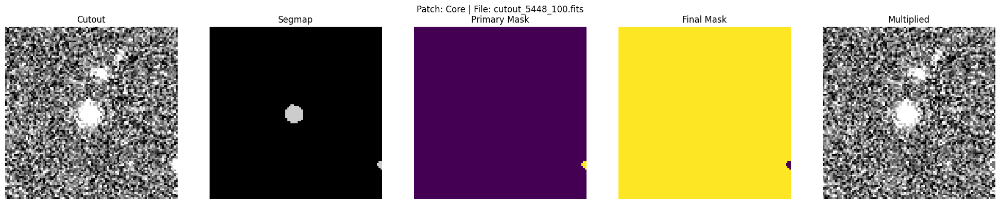

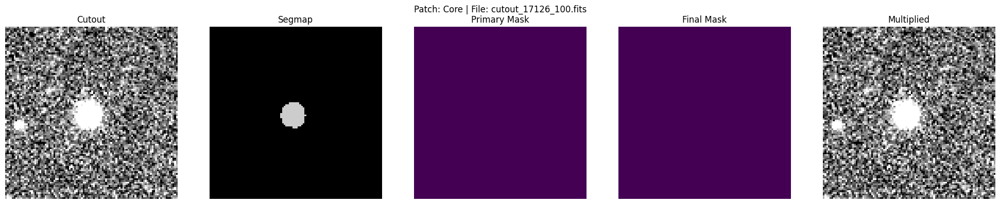

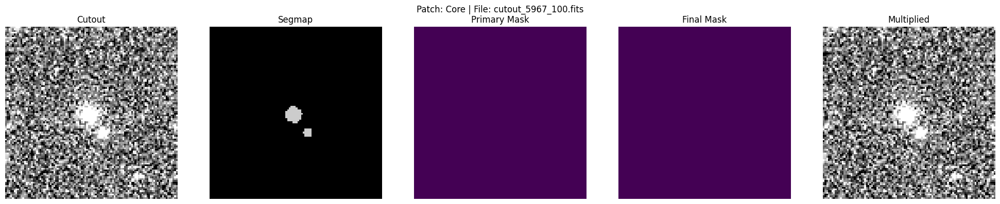

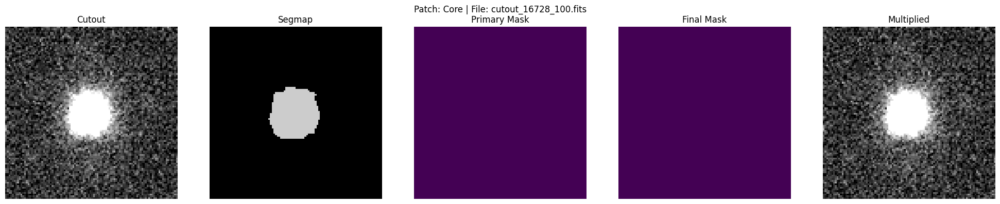

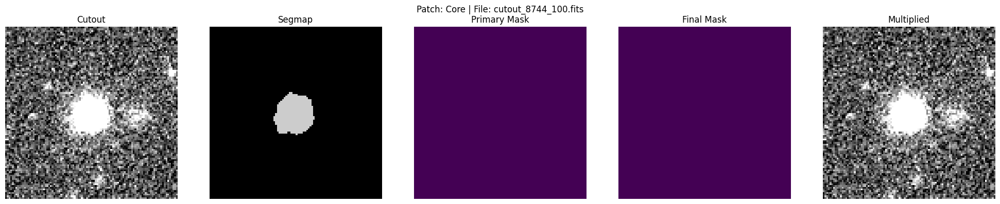

...

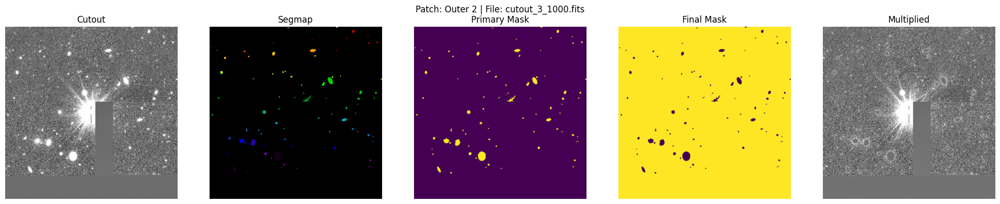

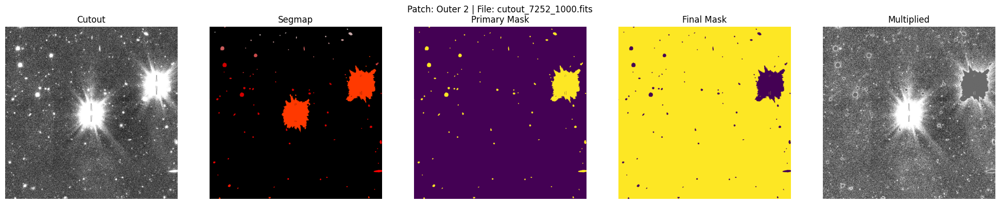

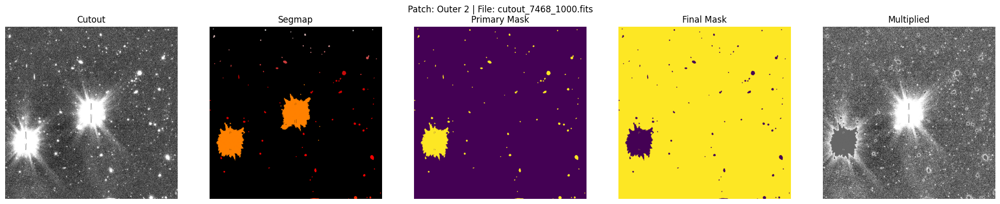

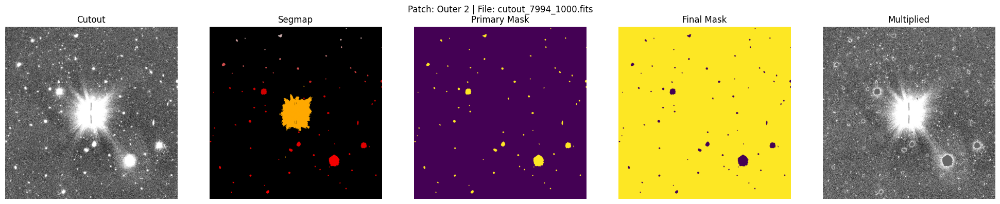

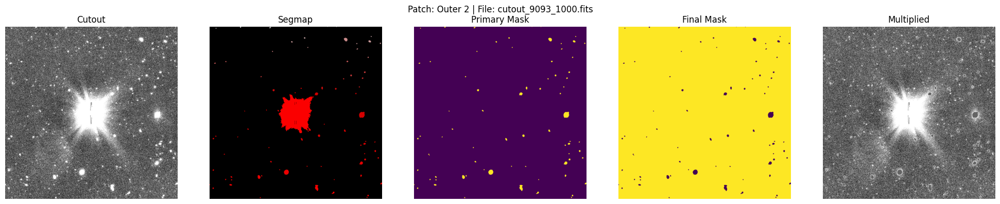

In [32]:
seg_path  = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/segmap_KIDS_9.5_-33.1.fits'
fits_file = '/home/rabbit/PSF_BuildUp/FITS_images/se_in_out/bkg_bySExtractor.fits'
cat_path  = '/home/rabbit/PSF_BuildUp/Query_results/gaia/gaia_matched_psf.csv'

# Patch definitions
PATCHES = [
    (1.3, 3.95, 15.8, 21.8, 100, 'Core'),
    (1.85, 6.1, 12.8, 15.7, 200, 'Intermediate'),
    (6.3, 11.6, 11.6, 13.25, 500, 'Outer 1'),
    (12, 18, 11, 12.2, 1000, 'Outer 2')
]

# Load catalog and FITS
cat = pd.read_csv(cat_path)
with fits.open(fits_file, memmap=True) as h:
    img = h[0].data
with fits.open(seg_path, memmap=True) as h:
    seg = h[0].data

# Create directories
for _, _, _, _, _, folder in PATCHES:
    for sub in ['cutouts', 'segmaps', 'primary_masking', 'final_masking', 'multiplied']:
        os.makedirs(os.path.join(folder, sub), exist_ok=True)

# Function to match star to patch
def get_patch(flux_radius, mag):
    for fr_min, fr_max, m_min, m_max, size, folder in PATCHES:
        if fr_min <= flux_radius <= fr_max and m_min <= mag <= m_max:
            return size, folder
    return None, None

# Generate cutouts and masks
for _, row in cat.iterrows():
    if row['GAIA_StarProb'] < 0.98:
        continue

    size, folder = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if size is None:
        continue

    x, y = row['X_IMAGE'], row['Y_IMAGE']

    # Cutout
    cutout_obj = Cutout2D(img, (x, y), (size, size), mode='partial', fill_value=0)
    cutout_data = cutout_obj.data
    cut_name = f'cutout_{int(row["NUMBER"])}_{size}.fits'
    fits.writeto(os.path.join(folder, 'cutouts', cut_name),
                 cutout_data.astype('float32'), overwrite=True)

    # Segmap cutout
    seg_cut = Cutout2D(seg, (x, y), (size, size), mode='partial', fill_value=0)
    seg_name = f'segmap_{cut_name}'
    fits.writeto(os.path.join(folder, 'segmaps', seg_name),
                 seg_cut.data.astype('int32'), overwrite=True)

    # Primary mask
    ny, nx = seg_cut.data.shape
    cy, cx = ny // 2, nx // 2
    target_id = seg_cut.data[cy, cx]
    if target_id == 0:
        continue
    primary_mask = np.where(seg_cut.data == target_id, 0, 1)
    primary_mask[seg_cut.data == 0] = 0
    fits.writeto(os.path.join(folder, 'primary_masking', cut_name),
                 primary_mask.astype('int32'), overwrite=True)

    # Final mask
    final_mask = 1 - primary_mask.astype('float32')
    fits.writeto(os.path.join(folder, 'final_masking', cut_name),
                 final_mask, overwrite=True)

    # Multiplied image
    multiplied = cutout_data * final_mask
    fits.writeto(os.path.join(folder, 'multiplied', cut_name),
                 multiplied.astype('float32'), overwrite=True)

# Plot cutouts
for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    segmaps_dir = os.path.join(folder, 'segmaps')
    primary_dir = os.path.join(folder, 'primary_masking')
    final_dir   = os.path.join(folder, 'final_masking')
    multiplied_dir = os.path.join(folder, 'multiplied')

    cutout_files = sorted([f for f in os.listdir(cutouts_dir) if f.endswith('.fits')])
    if not cutout_files:
        continue

    # For Outer 1 & Outer 2: show all; else random 5
    if folder in ['Outer 1', 'Outer 2']:
        files_to_show = cutout_files
    else:
        files_to_show = random.sample(cutout_files, min(5, len(cutout_files)))

    for fname in files_to_show:
        cutout = fits.getdata(os.path.join(cutouts_dir, fname))
        segmap = fits.getdata(os.path.join(segmaps_dir, f'segmap_{fname}'))
        primary_mask = fits.getdata(os.path.join(primary_dir, fname))
        final_mask = fits.getdata(os.path.join(final_dir, fname))
        multiplied = fits.getdata(os.path.join(multiplied_dir, fname))

        fig, axes = plt.subplots(1, 5, figsize=(20, 4))
        axes[0].imshow(cutout, cmap='gray', origin='lower',
                       vmin=np.percentile(cutout, 5), vmax=np.percentile(cutout, 95))
        axes[0].set_title('Cutout'); axes[0].axis('off')

        axes[1].imshow(segmap, cmap='nipy_spectral', origin='lower')
        axes[1].set_title('Segmap'); axes[1].axis('off')

        axes[2].imshow(primary_mask, cmap='viridis', origin='lower')
        axes[2].set_title('Primary Mask'); axes[2].axis('off')

        axes[3].imshow(final_mask, cmap='viridis', origin='lower')
        axes[3].set_title('Final Mask'); axes[3].axis('off')

        axes[4].imshow(multiplied, cmap='gray', origin='lower',
                       vmin=np.percentile(multiplied, 5), vmax=np.percentile(multiplied, 95))
        axes[4].set_title('Multiplied'); axes[4].axis('off')

        plt.suptitle(f'Patch: {folder} | File: {fname}', fontsize=12)
        plt.tight_layout()
        plt.show()

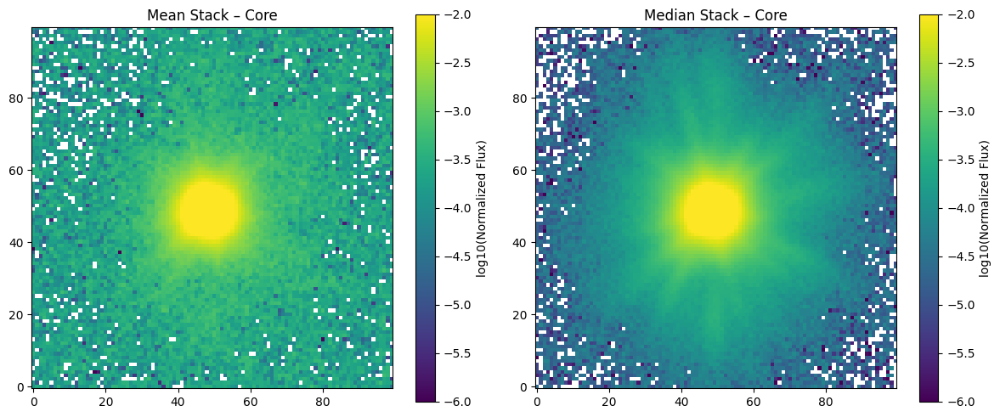

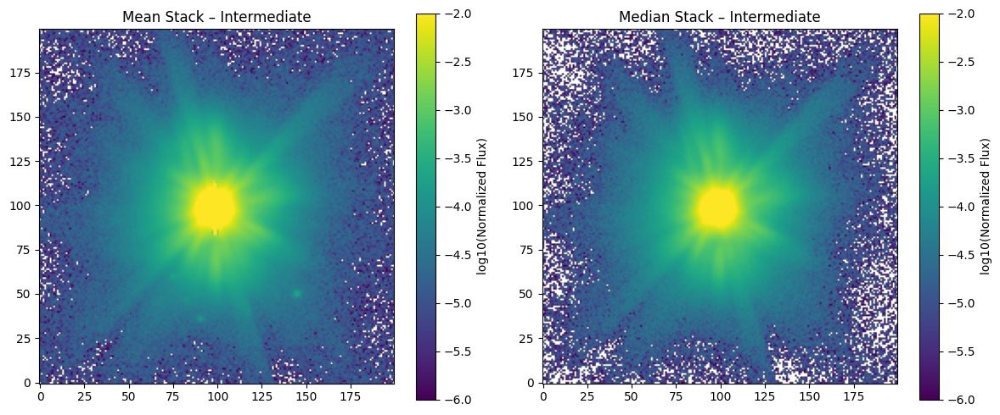

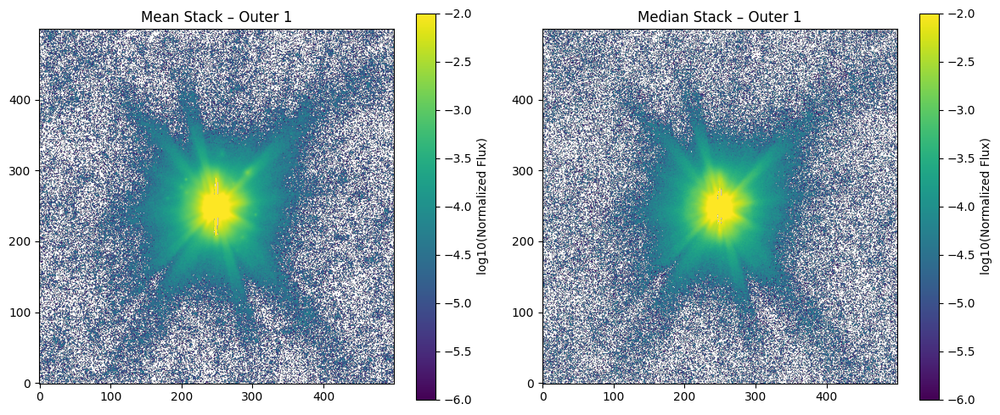

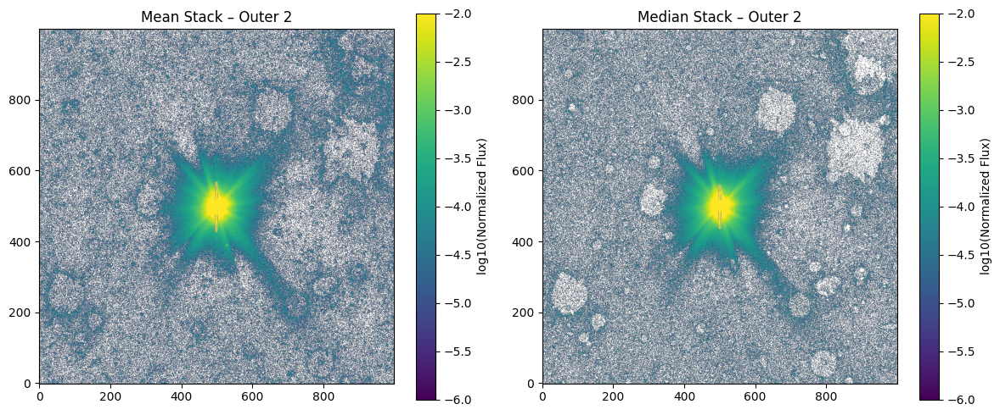

In [35]:
VMIN = -6
VMAX = -2
MIN_VALID_FRACTION = 0.4

STACK_GROUPS = {
    'Core': ['Core'],
    'Intermediate': ['Intermediate'],
    'Outer 1': ['Outer 1'],
    'Outer 2': ['Outer 2'],
}

PATCH_SIZES = {
    'Core': 100,
    'Intermediate': 200,
    'Outer 1': 500,
    'Outer 2': 1000,
}

for stack_name, patch_list in STACK_GROUPS.items():

    stacked_dir = os.path.join(stack_name, 'stacked')
    os.makedirs(stacked_dir, exist_ok=True)

    stack_list = []

    for patch in patch_list:
        multiplied_dir = os.path.join(patch, 'multiplied')

        if not os.path.isdir(multiplied_dir):
            print(f"Missing directory: {multiplied_dir}")
            continue

        multiplied_files = sorted(
            [f for f in os.listdir(multiplied_dir) if f.endswith('.fits')]
        )

        for fname in multiplied_files:
            fpath = os.path.join(multiplied_dir, fname)
            data = fits.getdata(fpath)

            expected_size = PATCH_SIZES[patch]
            if data.shape != (expected_size, expected_size):
                continue

            valid_mask = np.isfinite(data) & (data > 0)
            valid_fraction = np.sum(valid_mask) / data.size

            if valid_fraction < MIN_VALID_FRACTION:
                continue

            ny, nx = data.shape
            radius = min(nx, ny) // 2

            center_val = np.nanmax(
                data[
                    ny//2 - radius//10 : ny//2 + radius//10,
                    nx//2 - radius//10 : nx//2 + radius//10
                ]
            )

            if not (np.isfinite(center_val) and center_val > 0):
                continue

            stack_list.append(data / center_val)

    if len(stack_list) == 0:
        print(f"No valid PSFs for stack {stack_name}")
        continue

    stack_array = np.array(stack_list) 

    mean_stack   = np.nanmean(stack_array, axis=0)
    median_stack = np.nanmedian(stack_array, axis=0)

    fits.writeto(
        os.path.join(stacked_dir, f'mean_psf_{stack_name}.fits'),
        mean_stack.astype('float32'),
        overwrite=True
    )

    fits.writeto(
        os.path.join(stacked_dir, f'median_psf_{stack_name}.fits'),
        median_stack.astype('float32'),
        overwrite=True
    )

    def log_image(img):
        out = img.copy()
        out[out <= 0] = np.nan
        return np.log10(out)

    mean_plot   = log_image(mean_stack)
    median_plot = log_image(median_stack)

    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    im0 = axes[0].imshow(mean_plot, origin='lower', cmap='viridis', vmin=VMIN, vmax=VMAX)
    axes[0].set_title(f'Mean Stack – {stack_name}')
    plt.colorbar(im0, ax=axes[0], label='log10(Normalized Flux)')

    im1 = axes[1].imshow(median_plot, origin='lower', cmap='viridis', vmin=VMIN, vmax=VMAX)
    axes[1].set_title(f'Median Stack – {stack_name}')
    plt.colorbar(im1, ax=axes[1], label='log10(Normalized Flux)')

    plt.tight_layout()
    plt.show()

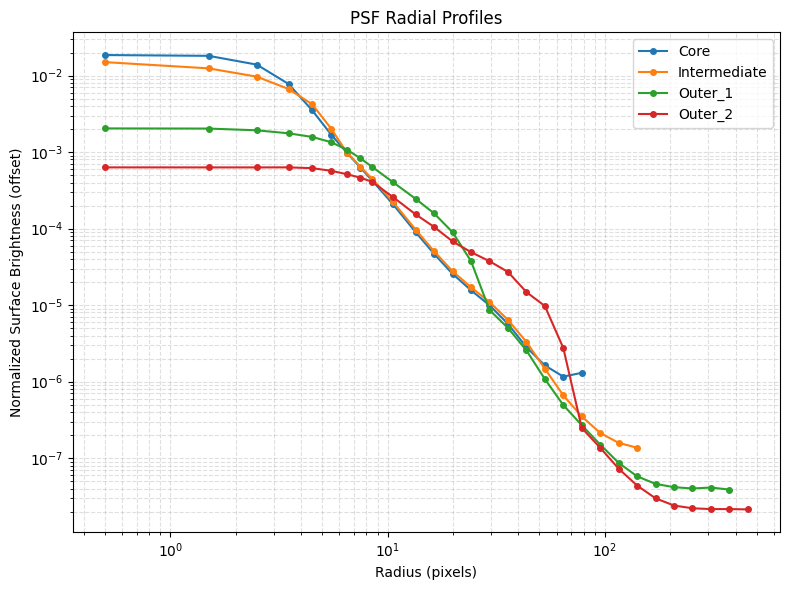

In [48]:
STACKS = {
    'Core': 'Core/stacked/median_psf_Core.fits',
    'Intermediate': 'Intermediate/stacked/median_psf_Intermediate.fits',
    'Outer_1': 'Outer 1/stacked/median_psf_Outer 1.fits',
    'Outer_2': 'Outer 2/stacked/median_psf_Outer 2.fits',
}


yshift = {
    'Core': 1,
    'Intermediate': 0.9,
    'Outer_1': 0.6,
    'Outer_2': 0.5,
}

radial_profiles = {}

radii_linear = np.arange(0, 10, 1)
radii_log = np.logspace(np.log10(10), np.log10(500), 21)
radii = np.concatenate([radii_linear, radii_log[1:]])

for name, fpath in STACKS.items():

    psf = fits.getdata(fpath)

    mask_invalid = ~np.isfinite(psf) | (psf <= 0)

    total_flux = np.nansum(psf[~mask_invalid])
    psf_norm = np.zeros_like(psf)
    psf_norm[~mask_invalid] = psf[~mask_invalid] / total_flux

    ny, nx = psf_norm.shape
    xycen = (nx / 2, ny / 2)

    rp = RadialProfile(psf_norm, xycen, radii, mask=mask_invalid)

    radial_profiles[name] = {
        'r': rp.radius,
        'profile': rp.profile
    }

plt.figure(figsize=(8, 6))

for name, data in radial_profiles.items():

    shifted_profile = data['profile'] * yshift[name]

    plt.plot(
        data['r'],
        shifted_profile,
        marker='o',
        markersize=4,
        linewidth=1.5,
        label=f"{name}"
    )

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Radius (pixels)')
plt.ylabel('Normalized Surface Brightness (offset)')
plt.title('PSF Radial Profiles')
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.legend()
plt.tight_layout()
plt.show()